<img src = "../image/cover.png" alt = "cover"/>

[*source*](https://earlygame.com/uploads/images/_body/nfs-reveal-week-14.jpg)


---

# Contents  

## Part 1 (The Data Science Problem - see Notebook 1)

## Part 2 (Image Classification - see Notebook 2)    

## [Part 3 (Object Detection)](#part3)  
### [3.1 Object Detection via Transfer Learning](#obtl)  
- #### [3.1.1 Darknet + YOLOv4](#dny4)  
- #### [3.1.2 PyTorch + YOLOv5](#pty5)  

### [3.2 Model Evaluation](#modelevaluation)  

### [3.3 Conclusion & Recommendation](#conrec)
- #### [3.3.1 Areas for Improvement](#afi)  
- #### [3.3.2 Business Recommendations](#businessrecommendations)   

---


<div id="part3"></div>

## Part 3 (Object Detection)  

The final notebook addresses the second goal of deploying an object detection model as set in the problem statement. For expediency, only pre-built object detection models are considered, specifically the Darknet + YOLOv4 and PyTorch + YOLOv5 models. 


In [1]:
# General Modules
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import os
import time
import glob
import win32gui, win32ui, win32con, win32api
import xml.etree.ElementTree as ET
from sklearn.metrics import confusion_matrix, f1_score

# Image Processing Modules
import cv2
import imutils
import matplotlib.image as mpimg
from PIL import ImageGrab
from IPython.display import Image, clear_output  

# Modelling (CNN) Modules
import tensorflow as tf
from tensorflow.keras import Model, optimizers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, GlobalAveragePooling2D, BatchNormalization
from tensorflow.keras import utils
from tensorflow.keras.regularizers import l2
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.applications.vgg16 import VGG16, preprocess_input, decode_predictions
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input, decode_predictions


<div id="obtl"></div>

### 3.1 Object Detection via Transfer Learning

The object detection segment of the project is largely exploratory and experimental. For this reason, the focus is primarily on deploying the pre-built models without additional tuning and modification. Further, only the YOLOv5 model will be trained on the custom pedestrian dataset utilized throughout this project. 

Before diving into the objection detection models, an elementary understanding on the foundational YOLO architecture is required. The term YOLO is an acronym for 'You Only Look Once', the first object detection network which combines the demarcating bounding boxes and identifying class labels in an end-to-end differentiable network written by Joseph Redmon in 2015 ([*source*](https://medium.com/aiguys/yolo-v4-explained-in-full-detail-5200b77aa825)). Given the complex nature of the YOLO architecture (as shown in Fig 7 below), we will not explicate the details but a noteworthy point is that the YOLOv4 model which this project deploys is a two-stage detector. Where deep learning is concerned, multiple layers in the respective stages (e.g. backbone, neck, heads) leverages on CNN models such as VGG16, ResNet-50, EfficientNet and Faster R-CNN to name a few. For more information on the YOLO architecture, please refer to [*here*](https://medium.com/aiguys/yolo-v4-explained-in-full-detail-5200b77aa825) and [*here*](https://blog.roboflow.com/a-thorough-breakdown-of-yolov4/). 

<img src = "../image/yolo.png" alt = "yolo_archi"/>

*Fig. 7 YOLO Architecture* ([*source*](https://miro.medium.com/max/1398/1*di4P5hZwH3qgOd_m7KoVzw.png))

Lastly, YOLO models are trained on the COCO dataset comprising ~330,000 images (>200K labeled) and ~1.5 million object instances over 80 object categories ([*source*](https://cocodataset.org/#home)). 


<div id="dny4"></div>

#### 3.1.1 Darknet + YOLOv4  

Darknet is a custom framework (think along the lines of TensorFlow, PyTorch etc.) tailored for object detection in CV employed by Redmon since the first YOLO version ([*source*](https://pjreddie.com/darknet/)). At present, it is still employed by Alexey Bochkovskiy et al. (2020) in the latest YOLOv4 model ([*source*](https://github.com/pjreddie/darknet)). 

*NOTE: The Darknet+YOLOv4 model was deployed locally via GPU (NVIDIA GeForce GTX1080) with OpenCV 4.5.5, CUDA 11.6 and CUDNN 8.3.2*  


In [2]:
# Check OpenCV version
cv2.__version__


'4.5.5'

In [3]:
# Check GPU details 
!nvidia-smi


Tue Mar  1 23:28:41 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 511.65       Driver Version: 511.65       CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ... WDDM  | 00000000:0B:00.0  On |                  N/A |
|  0%   44C    P8    13W / 230W |    833MiB /  8192MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [4]:
# Check CUDA version
!nvcc -V


nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Fri_Dec_17_18:28:54_Pacific_Standard_Time_2021
Cuda compilation tools, release 11.6, V11.6.55
Build cuda_11.6.r11.6/compiler.30794723_0


In [5]:
# Clone the official darknet+yolov4 model (DO NOT RUN AGAIN)
## !git clone https://github.com/AlexeyAB/darknet.git


In [6]:
cd ../model/darknet


C:\Users\Nicho\Courses\General Assembly\DSI\Computer\Capstone\Final\model\darknet


In [7]:
# Check files in darknet directory
!dir


 Volume in drive C is Potato Core
 Volume Serial Number is 5C49-DC43

 Directory of C:\Users\Nicho\Courses\General Assembly\DSI\Computer\Capstone\Final\model\darknet

03/01/2022  09:49 PM    <DIR>          .
03/01/2022  09:49 PM    <DIR>          ..
03/01/2022  09:49 PM    <DIR>          .circleci
03/01/2022  09:49 PM    <DIR>          .github
02/14/2022  10:55 AM               752 .gitignore
03/01/2022  09:49 PM    <DIR>          3rdparty
02/12/2022  12:48 AM        17,670,144 avcodec-58.dll
02/12/2022  12:48 AM         3,076,608 avformat-58.dll
02/12/2022  12:48 AM           771,072 avutil-56.dll
02/27/2022  11:49 AM                42 bad.list
03/01/2022  09:49 PM    <DIR>          build
02/14/2022  01:16 PM             2,860 build.log
02/14/2022  10:55 AM            32,262 build.ps1
03/01/2022  09:49 PM    <DIR>          build_release
03/01/2022  09:49 PM    <DIR>          cfg
03/01/2022  09:49 PM    <DIR>          cmake
02/14/2022  10:55 AM            25,358 CMakeLists.txt
02/14/20

In [8]:
# Info on Makefile to create darknet program
## !type Makefile


In [9]:
# Configure Makefile to operate model on GPU (DO NOT RUN AGAIN) 
## !sed -i 's/OPENCV=0/OPENCV=1/g' Makefile
## !sed -i 's/GPU=0/GPU=1/g' Makefile
## !sed -i 's/CUDNN=0/CUDNN=1/g' Makefile
## !sed -i 's/CUDNN_HALF=0/CUDNN_HALF=1/' Makefile


In [10]:
# Create darknet program (DO NOT RUN AGAIN)
##!\build.ps1 -UseVCPKG -EnableOPENCV -EnableCUDA -EnableCUDNN


In [11]:
# Feed recorded images into darknet model
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/ntu1.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/ntu2.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/ntu3.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/ntu4.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_day1.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_day2.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_day3.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_day4.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_night1.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_night2.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_night3.png -i 0 -thresh 0.25
!darknet detector test cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_night4.png -i 0 -thresh 0.25


net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/ntu1.png: Predicted in 332.359000 milli-seconds.
person: 99%
person: 99%
person: 77%
person: 90%
person: 43%
person: 48%
person: 98%
person: 94%
person: 92%
car: 30%
person: 31%
person: 26%
person: 28%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/ntu2.png: Predicted in 333.887000 milli-seconds.
person: 99%
person: 43%
car: 28%
person: 53%
person: 37%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/ntu3.png: Predicted in 339.022000 milli-seconds.
car: 63%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/ntu4.png: Predicted in 337.304000 milli-seconds.
car: 88%
fire hydrant: 58%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/orchard_day1.png: Predicted in 345.292000 milli-seconds.
truck: 28%
car: 71%
bicycle: 29%
motorbike: 55%
car: 67%
person: 96%
car: 98%
car: 50%
motorbike: 90%
person: 64%
person: 27%
car: 43%
person: 100%
person: 95%
car: 97%
car: 79%
person: 95%
car: 99%
car: 89%
person: 98%
car: 75%
car: 98%
person: 99%
car: 93%
car: 72%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/orchard_day2.png: Predicted in 342.384000 milli-seconds.
person: 89%
person: 44%
person: 62%
person: 91%
bus: 75%
car: 99%
car: 35%
car: 34%
car: 28%
car: 96%
person: 28%
person: 27%
person: 53%
person: 42%
person: 28%
person: 71%
traffic light: 74%
traffic light: 49%
person: 65%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/orchard_day3.png: Predicted in 330.685000 milli-seconds.
car: 100%
car: 98%
car: 76%
truck: 92%
car: 94%
car: 89%
car: 96%
car: 100%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/orchard_day4.png: Predicted in 330.407000 milli-seconds.
car: 36%
car: 27%
car: 59%
car: 93%
bus: 97%
car: 99%
car: 99%
car: 56%
truck: 80%
car: 60%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/orchard_night1.png: Predicted in 347.598000 milli-seconds.
person: 98%
handbag: 56%
handbag: 51%
person: 96%
car: 95%
handbag: 39%
person: 83%
person: 95%
car: 97%
chair: 61%
person: 99%
car: 31%
chair: 38%
car: 33%
person: 92%
person: 99%
backpack: 61%
handbag: 37%
car: 77%
person: 97%
person: 95%
car: 85%
car: 57%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/orchard_night2.png: Predicted in 337.552000 milli-seconds.
car: 99%
car: 40%
car: 100%
car: 96%
car: 32%
car: 42%
person: 81%
person: 74%
person: 93%
person: 92%
person: 77%
person: 40%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/orchard_night3.png: Predicted in 332.967000 milli-seconds.
car: 100%
bus: 91%
car: 100%
car: 96%
car: 55%
car: 41%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
 Detection layer: 139 - type = 28 
 Detection layer: 150 - type = 28 
 Detection layer: 161 - type = 28 
data/orchard_night4.png: Predicted in 335.841000 milli-seconds.
car: 96%
person: 26%
car: 26%
car: 100%
car: 98%
car: 49%
chair: 52%
car: 98%
traffic light: 32%
car: 79%
truck: 60%
car: 97%
chair: 86%


 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

The resultant images are printed below for ease of reference: 


<img src = "../image/ntu_yv4.png" alt = "ntu_yv4"/>

*Fig. 8a Darknet + YOLOv4 for NTU* 

<img src = "../image/orchard_day_yv4.png" alt = "orchard_day_yv4"/>

*Fig. 8b Darknet + YOLOv4 for Orchard (Day)* 

<img src = "../image/orchard_night_yv4.png" alt = "orchard_night_yv4"/>

*Fig. 8c Darknet + YOLOv4 for Orchard (Night)* 


In [12]:
# Feed self-recorded video into darknet model
!darknet detector demo cfg/coco.data cfg/yolov4.cfg yolov4.weights data/ntu.mp4 -i 0 -thresh 0.25
!darknet detector demo cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_day.mp4 -i 0 -thresh 0.25
!darknet detector demo cfg/coco.data cfg/yolov4.cfg yolov4.weights data/orchard_night.mp4 -i 0 -thresh 0.25
## Results are not printed; run codes to view results 


Demo
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
video file: data/ntu.mp4
Video stream: 1280 x 720 
Objects:


FPS:0.0 	 AVG_FPS:0.0
Objects:


FPS:2.0 	 AVG_FPS:0.0
Objects:


FPS:3.3 	 AVG_FPS:0.0
Objects:


FPS:5.1 	 AVG_FPS:0.0
Objects:

car: 30% 

FPS:6.7 	 AVG_FPS:0.0
Objects:

car: 33% 
car: 30% 

FPS:8.1 	 AVG_FPS:0.0
Objects:

car: 70% 
car: 64% 

FPS:9.3 	 AVG_FPS:0.0
Objects:

car: 59% 
car: 46% 
car: 40% 

FPS:10.5 	 AVG_FPS:0.0
Objects:

car: 53% 
car: 40% 
car: 30% 
person: 26% 

FPS:11.5 	 AVG_FPS:0.0
Objects:

car: 61% 
car: 57% 

FPS:12.5 	 AVG_FPS:0.0
Objects:


FPS:13.3 	 AVG_FPS:0.0
Objects:

car: 28% 
car: 51% 

FPS:14.0 	 AVG_FPS:0.0
Objects:

car: 41% 
car: 34% 

FPS:14.7 	 AVG_FPS:0.0
Objects:

car:

 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv


FPS:18.5 	 AVG_FPS:0.0
Objects:


FPS:18.7 	 AVG_FPS:0.0
Objects:


FPS:18.9 	 AVG_FPS:0.0
Objects:

bus: 51% 
car: 39% 

FPS:19.1 	 AVG_FPS:0.0
Objects:

truck: 38% 
bus: 60% 
car: 43% 

FPS:19.3 	 AVG_FPS:0.0
Objects:

bus: 42% 
car: 41% 
car: 46% 

FPS:19.4 	 AVG_FPS:0.0
Objects:

parking meter: 30% 
bus: 68% , truck: 29% 
car: 32% 

FPS:19.6 	 AVG_FPS:0.0
Objects:

truck: 34% 
bus: 72% 
car: 32% 
car: 36% 
car: 39% 

FPS:19.7 	 AVG_FPS:0.0
Objects:

bus: 81% 
car: 26% 

FPS:19.8 	 AVG_FPS:0.0
Objects:

truck: 27% 
bus: 77% 

FPS:19.9 	 AVG_FPS:0.0
Objects:

truck: 38% 
bus: 64% 
car: 72% 

FPS:20.0 	 AVG_FPS:0.0
Objects:

truck: 45% 
bus: 60% 
car: 42% 

FPS:20.1 	 AVG_FPS:0.0
Objects:

truck: 54% 
bus: 67% 
car: 31% 

FPS:20.2 	 AVG_FPS:0.0
Objects:

bus: 77% , truck: 47% 
car: 76% 

FPS:20.2 	 AVG_FPS:0.0
Objects:

bus: 92% 
car: 75% 

FPS:20.3 	 AVG_FPS:0.0
Objects:

truck: 26% 
car: 47% 
bus: 90% 

FPS:20.3 	 AVG_FPS:0.0
Objects:

bus: 94% 

FPS:20.4 	 AVG_FPS:0.0
Objects:

bu

 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv

net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
video file: data/orchard_day.mp4
Video stream: 1280 x 720 
Objects:


FPS:0.0 	 AVG_FPS:0.0
Objects:

traffic light: 82% 
traffic light: 64% 
traffic light: 53% 
traffic light: 48% 
traffic light: 46% 
traffic light: 28% 
car: 89% 
car: 64% 
car: 54% 
car: 93% 
car: 99% 
car: 95% 
car: 97% 
car: 99% 
bus: 76% 
car: 100% 
person: 88% 

FPS:2.0 	 AVG_FPS:0.0
Objects:

traffic light: 89% 
traffic light: 69% 
traffic light: 60% 
traffic light: 58% 
car: 93% 
car: 91% 
car: 80% 
car: 80% 
car: 97% 
car: 38% 
car: 34% 
car: 98% 
car: 99% 
car: 100% 
bus: 90% 
person: 54% 
person: 96% 

FPS:3.9 	 AVG_FPS:0.0
Objects:

traffic light: 84% 
traffic light: 83% 
traffic light: 81% 
traffic l

Demo
net.optimized_memory = 0 
mini_batch = 1, batch = 8, time_steps = 1, train = 0 
Create CUDA-stream - 0 
 Create cudnn-handle 0 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 
nms_kind: greedynms (1), beta = 0.600000 

 seen 64, trained: 32032 K-images (500 Kilo-batches_64) 
video file: data/orchard_night.mp4
Video stream: 1280 x 720 
Objects:


FPS:0.0 	 AVG_FPS:0.0
Objects:

traffic light: 66% 
traffic light: 44% 
car: 34% 
car: 26% 
person: 37% 
car: 32% 
person: 44% 
person: 56% 
person: 62% 
car: 98% 
person: 34% 
bus: 86% 
car: 99% 
person: 65% 
car: 99% 

FPS:2.1 	 AVG_FPS:0.0
Objects:

traffic light: 75% 
traffic light: 62% 
car: 66% 
car: 43% 
car: 30% 
person: 27% 
person: 65% 
person: 38% 
person: 52% 
car: 98% 
bus: 77% 
car: 99% 
car: 99% 

FPS:4.0 	 AVG_FPS:0.0
Objects:

traffic light: 74% 
traffic light: 62% 
car: 62% 
car: 98% 
car: 32% 
car: 29% 
person: 29% 
person: 65% 
person: 38% 
person: 39% 
person: 44% 
person: 27% 
car: 

 CUDA-version: 11060 (11060), cuDNN: 8.3.2, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 610, cudnn_half = 0, GPU: NVIDIA GeForce GTX 1080 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   3 route  1 		                           ->  304 x 304 x  64 
   4 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   5 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   6 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   7 Shortcut Layer: 4,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   8 conv     64       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  64 0.757 BF
   9 route  8 2 	                           ->  304 x 304 x 128 
  10 conv


bus: 40% 
car: 98% 

FPS:5.7 	 AVG_FPS:0.0
Objects:

traffic light: 79% 
car: 97% 
car: 68% 
car: 98% 
car: 36% 
car: 34% 
car: 31% 
person: 33% 
person: 75% 
person: 39% 
person: 29% 
person: 51% 
bus: 59% 
car: 98% 

FPS:7.2 	 AVG_FPS:0.0
Objects:

traffic light: 61% 
traffic light: 60% 
traffic light: 25% 
car: 58% 
car: 96% 
car: 39% 
car: 38% 
car: 33% 
person: 31% 
person: 39% 
person: 52% 
person: 70% 
person: 32% 
car: 98% 
bus: 72% 
car: 98% 

FPS:8.5 	 AVG_FPS:0.0
Objects:

traffic light: 79% 
traffic light: 34% 
traffic light: 31% 
car: 66% 
car: 44% 
car: 30% 
person: 68% 
person: 34% 
person: 29% 
person: 38% 
person: 61% 
person: 67% 
car: 97% 
car: 97% 
bus: 54% 
car: 98% 

FPS:9.8 	 AVG_FPS:0.0
Objects:

traffic light: 89% 
traffic light: 42% 
car: 64% 
car: 63% 
car: 47% 
car: 26% 
car: 25% 
person: 28% 
person: 29% 
person: 67% 
person: 40% 
car: 96% 
car: 97% 
car: 99% 

FPS:10.9 	 AVG_FPS:0.0
Objects:

traffic light: 86% 
traffic light: 50% 
car: 67% 
car: 62% 
car

From the images in Fig. 8 above, the Darknet + YOLOv4 model performs fairly well in identifying pedestrians, and this is unsurprising given that it is considered a state-of-the-art model trained on the comprehensive COCO dataset. However, for good measure, we will train an object detection model on our custom pedestrian dataset, and this is where we turn to the PyTorch + YOLOv5 model in the next section. 


<div id="pty5"></div>

#### 3.1.2 PyTorch + YOLOv5

While there is resemblance in the YOLOv5 model naming, it is in fact developed by Glenn Jocher and Ultralytics, a different author and community altogether ([*source*](https://pytorch.org/hub/ultralytics_yolov5/)). Without going into the intricacies, the main difference between YOLOv4 and YOLOv5 architecture lies in the backbone component. In terms of application, darknet does not support the YOLOv5 model, in part explaining the choice of PyTorch as the underlying framework. More importantly, with the ongoing collaboration between Ultralytics and Roboflow, bounding box demarcation and object annotation is enabled as part of YOLOv5 implementation, in turn allowing the model to be trained on our pedestrian dataset to generate custom weights. 

*NOTE: Due to system conflicts, the entirety of this sub-section is ran on Google Colab.* 


In [2]:
!git clone https://github.com/ultralytics/yolov5


Cloning into 'yolov5'...
remote: Enumerating objects: 11142, done.
remote: Total 11142 (delta 0), reused 0 (delta 0), pack-reused 11142
Receiving objects: 100% (11142/11142), 11.14 MiB | 11.01 MiB/s, done.
Resolving deltas: 100% (7699/7699), done.


In [3]:
%cd yolov5


/content/yolov5


In [4]:
%pip install -qr requirements.txt


     |████████████████████████████████| 596 kB 4.4 MB/s 


In [5]:
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Setup complete. Using torch 1.10.0+cu111 (Tesla K80)


In [6]:
%pip install -q roboflow


     |████████████████████████████████| 145 kB 6.7 MB/s 
     |████████████████████████████████| 1.1 MB 39.1 MB/s 
     |████████████████████████████████| 67 kB 5.6 MB/s 
     |████████████████████████████████| 138 kB 39.7 MB/s 
     |████████████████████████████████| 178 kB 43.4 MB/s 
     |████████████████████████████████| 63 kB 1.6 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [7]:
%pip install wandb


     |████████████████████████████████| 1.7 MB 4.2 MB/s 
     |████████████████████████████████| 181 kB 38.2 MB/s 
     |████████████████████████████████| 144 kB 46.8 MB/s 
     |████████████████████████████████| 63 kB 1.8 MB/s 
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8806 sha256=e42529a707eb34432793b0a4ae7c57b2b50b9f2273d4523c6256268b5cb527b1
  Stored in directory: /root/.cache/pip/wheels/3e/31/09/fa59cef12cdcfecc627b3d24273699f390e71828921b2cbba2
Successfully built pathtools


In [8]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")


upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [9]:
os.environ["DATASET_DIRECTORY"] = "/content/datasets"


In [10]:
rf = Roboflow(api_key="8u3V9WJDkQhjl4XKaI5e")
project = rf.workspace().project("pedestrians-5szlx")
dataset = project.version(3).download("yolov5")


loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/pedestrians-3 in yolov5pytorch:: 100%|██████████| 1616/1616 [00:02<00:00, 701.14it/s]


In [11]:
!python train.py --img 416 --batch 16 --epochs 150 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache


wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: (30 second timeout) 
wandb: W&B disabled due to login timeout.
train: weights=yolov5s.pt, cfg=, data=/content/datasets/pedestrians-3/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0

In [12]:
%load_ext tensorboard
%tensorboard --logdir runs


<IPython.core.display.Javascript object>

In [13]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/155 /content/datasets/pedestrians-3/test/images/image--1-_jpg.rf.ec850ceedf2030a036f9887deb6f0d17.jpg: 416x416 1 person, Done. (0.026s)
image 2/155 /content/datasets/pedestrians-3/test/images/image--10-_jpg.rf.9a831efac7252b2c279829cf344b7bc4.jpg: 416x416 3 persons, Done. (0.026s)
image 3/155 /content/datasets/pedestrians-3/test/images/image

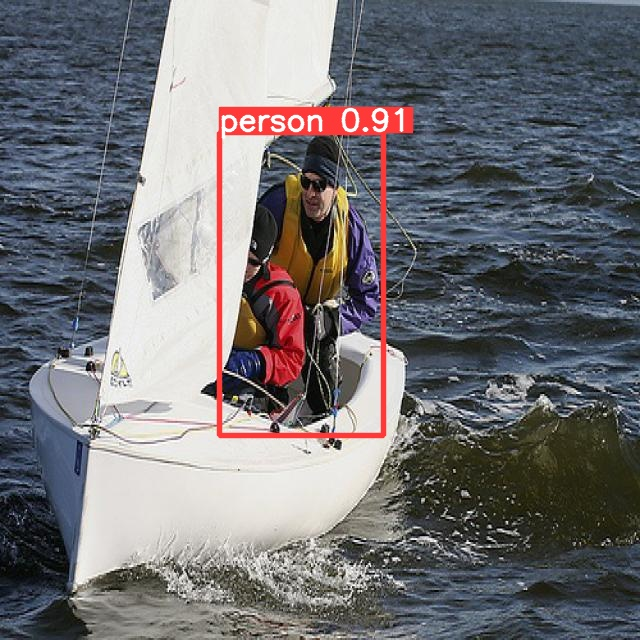

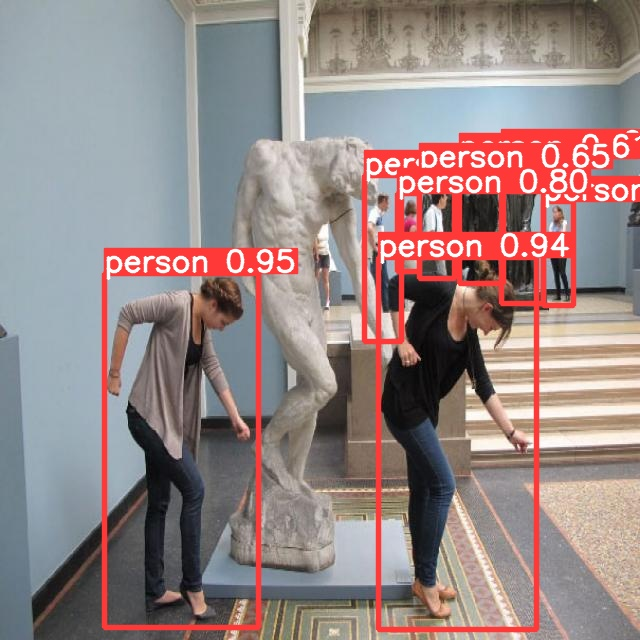

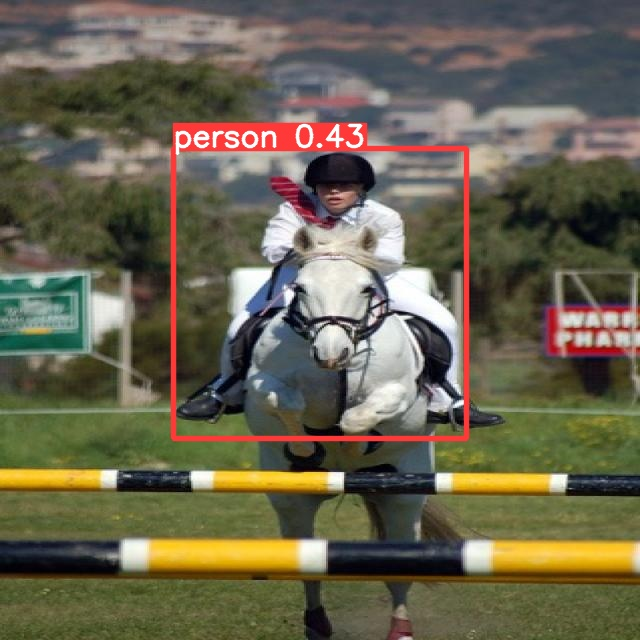

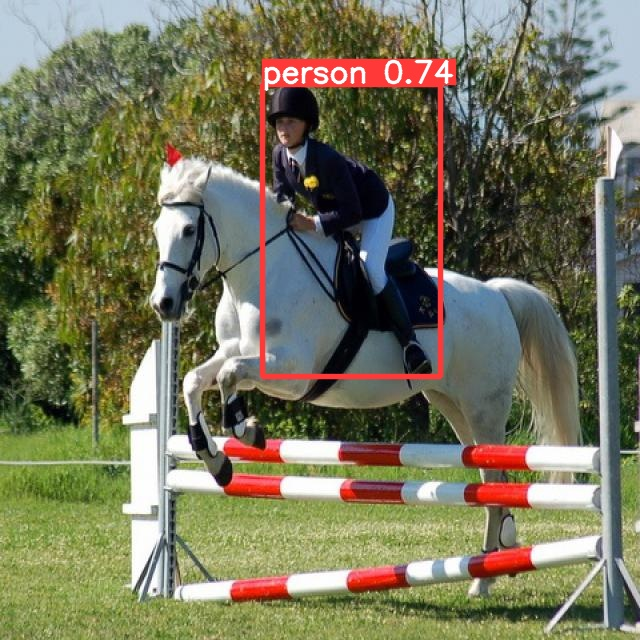

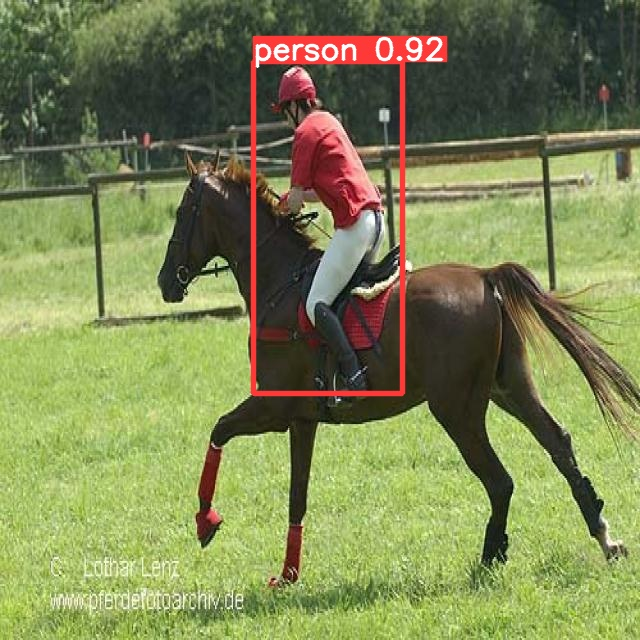

...

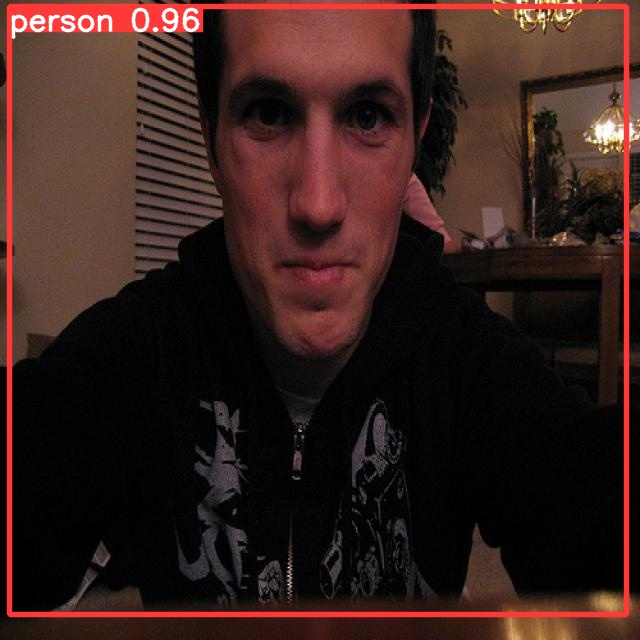

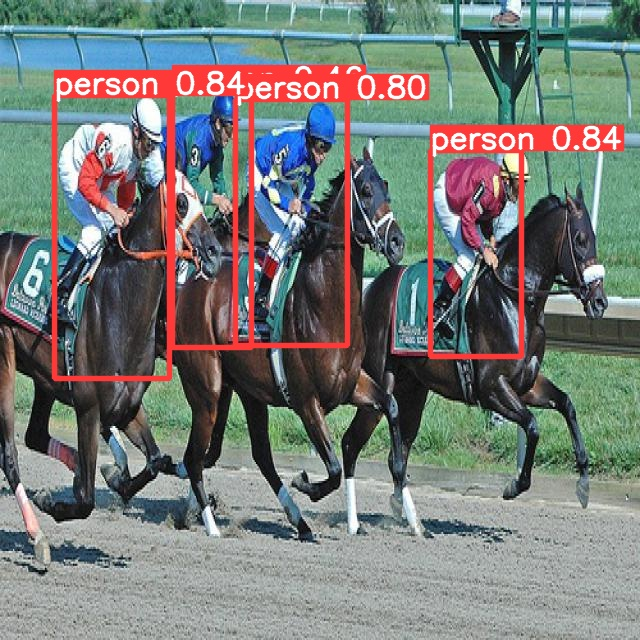

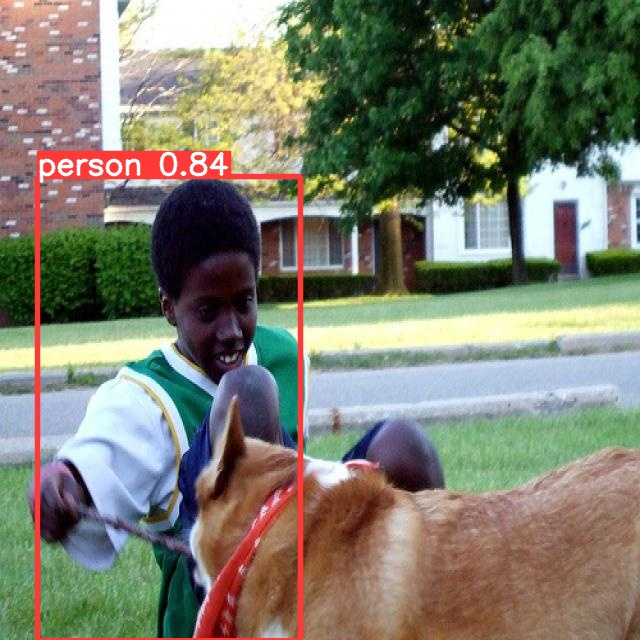

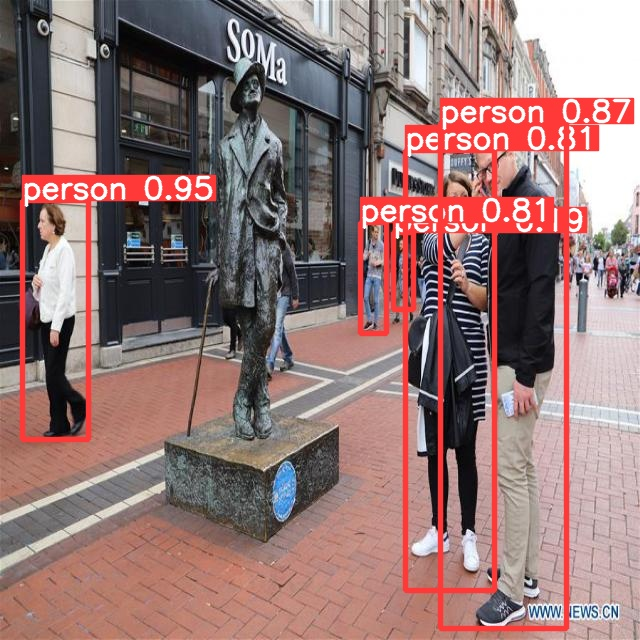

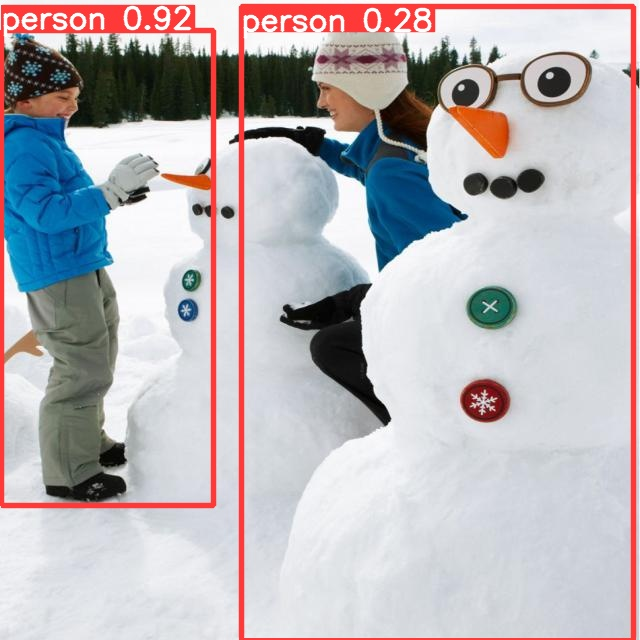

In [ ]:
for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): 
    display(Image(filename=imageName))
    print("\n")
    

In [14]:
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [18]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/ntu1.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/ntu1.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/ntu1.PNG: 384x640 4 persons, Done. (0.028s)
Speed: 0.4ms pre-process, 27.7ms inference, 2.0ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp5


In [19]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/ntu2.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/ntu2.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/ntu2.PNG: 384x640 5 persons, Done. (0.028s)
Speed: 0.6ms pre-process, 27.5ms inference, 2.2ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp6


In [20]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/ntu3.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/ntu3.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/ntu3.PNG: 416x640 Done. (0.029s)
Speed: 0.5ms pre-process, 28.5ms inference, 0.6ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp7


In [21]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/ntu4.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/ntu4.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/ntu4.PNG: 416x640 Done. (0.028s)
Speed: 0.5ms pre-process, 28.3ms inference, 0.7ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp8


In [22]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_day1.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/orchard_day1.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/orchard_day1.PNG: 384x640 6 persons, Done. (0.028s)
Speed: 0.4ms pre-process, 27.7ms inference, 2.2ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp9


In [23]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_day2.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/orchard_day2.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/orchard_day2.PNG: 384x640 5 persons, Done. (0.028s)
Speed: 0.4ms pre-process, 27.6ms inference, 2.0ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp10


In [24]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_day3.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/orchard_day3.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/orchard_day3.PNG: 480x640 Done. (0.030s)
Speed: 0.5ms pre-process, 30.2ms inference, 0.8ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp11


In [25]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_day4.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/orchard_day4.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/orchard_day4.PNG: 384x640 Done. (0.028s)
Speed: 0.5ms pre-process, 27.7ms inference, 0.8ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp12


In [26]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_night1.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/orchard_night1.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/orchard_night1.PNG: 384x640 9 persons, Done. (0.028s)
Speed: 0.5ms pre-process, 27.5ms inference, 2.1ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp13


In [27]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_night2.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/orchard_night2.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/orchard_night2.PNG: 384x640 1 person, Done. (0.028s)
Speed: 0.5ms pre-process, 27.5ms inference, 2.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp14


In [28]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_night3.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/orchard_night3.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/orchard_night3.PNG: 384x640 Done. (0.027s)
Speed: 0.5ms pre-process, 27.4ms inference, 0.7ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp15


In [29]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_night4.PNG


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/orchard_night4.PNG, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/datasets/pedestrians-3/orchard_night4.PNG: 384x640 Done. (0.027s)
Speed: 0.4ms pre-process, 27.4ms inference, 0.8ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp16


In [30]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/ntu.mp4


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/pedestrians-3/ntu.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
video 1/1 (1/3597) /content/datasets/pedestrians-3/ntu.mp4: 384x640 Done. (0.028s)
video 1/1 (2/3597) /content/datasets/pedestrians-3/ntu.mp4: 384x640 Done. (0.027s)
video 1/1 (3/3597) /content/datasets/pedestrians-3/ntu.mp4: 384x640 Done. (0.027s)
video 1/1 (4/3597) /content/datasets/pedestrians-3/ntu.mp4: 384x640 Done. (0.027s)
video 1/1 (5/3597) /co

In [31]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_day.mp4


Streaming output truncated to the last 5000 lines.
video 1/1 (404/5401) /content/datasets/pedestrians-3/orchard_day.mp4: 384x640 6 persons, Done. (0.028s)
video 1/1 (405/5401) /content/datasets/pedestrians-3/orchard_day.mp4: 384x640 6 persons, Done. (0.028s)
video 1/1 (406/5401) /content/datasets/pedestrians-3/orchard_day.mp4: 384x640 6 persons, Done. (0.028s)
video 1/1 (407/5401) /content/datasets/pedestrians-3/orchard_day.mp4: 384x640 6 persons, Done. (0.028s)
video 1/1 (408/5401) /content/datasets/pedestrians-3/orchard_day.mp4: 384x640 6 persons, Done. (0.028s)
video 1/1 (409/5401) /content/datasets/pedestrians-3/orchard_day.mp4: 384x640 6 persons, Done. (0.028s)
video 1/1 (410/5401) /content/datasets/pedestrians-3/orchard_day.mp4: 384x640 6 persons, Done. (0.028s)
video 1/1 (411/5401) /content/datasets/pedestrians-3/orchard_day.mp4: 384x640 6 persons, Done. (0.028s)
video 1/1 (412/5401) /content/datasets/pedestrians-3/orchard_day.mp4: 384x640 6 persons, Done. (0.028s)
video 1/1 (41

In [32]:
!python detect.py --weights runs/train/exp/weights/best.pt --source {dataset.location}/orchard_night.mp4


Streaming output truncated to the last 5000 lines.
video 1/1 (403/5403) /content/datasets/pedestrians-3/orchard_night.mp4: 384x640 10 persons, Done. (0.028s)
video 1/1 (404/5403) /content/datasets/pedestrians-3/orchard_night.mp4: 384x640 9 persons, Done. (0.027s)
video 1/1 (405/5403) /content/datasets/pedestrians-3/orchard_night.mp4: 384x640 10 persons, Done. (0.027s)
video 1/1 (406/5403) /content/datasets/pedestrians-3/orchard_night.mp4: 384x640 9 persons, Done. (0.027s)
video 1/1 (407/5403) /content/datasets/pedestrians-3/orchard_night.mp4: 384x640 10 persons, Done. (0.028s)
video 1/1 (408/5403) /content/datasets/pedestrians-3/orchard_night.mp4: 384x640 9 persons, Done. (0.027s)
video 1/1 (409/5403) /content/datasets/pedestrians-3/orchard_night.mp4: 384x640 10 persons, Done. (0.027s)
video 1/1 (410/5403) /content/datasets/pedestrians-3/orchard_night.mp4: 384x640 10 persons, Done. (0.027s)
video 1/1 (411/5403) /content/datasets/pedestrians-3/orchard_night.mp4: 384x640 9 persons, Done.

<div id="modelevaluation"></div>

### 3.2 Model Evaluation


<img src = "../image/map.png" alt = "map"/>

*Mean Average Precision Score for PyTorch + YOLOv5 Model Trained on Custom Pedestrian Dateset* 

Model Summary:  

|Precision|Recall|mAP @ IoU = 0.5|
|---|---|---|
|0.924|0.815|0.879|

Earlier under the model framework, a stringent threshold of 90% was established for the mAP score, reason being that it was the sole albeit most comprehensive proxy assessed. The PyTorch + YOLOv5 returned a highest mAP score of 0.879 on the test set, signalling to a competent model although it falls slightly short of the 90% criteria. By interpretation, at the IoU threshold of 0.5 (i.e. IoU >= 0.5: identified as person object (class 1); IoU < 0.5: identified as non-person object (class 0)), the average of the mean precisions across both classes is 0.879. Generally, this higher average precision is translated to the model having a high level of accuracy in predicting actual positives (True Positives). As such, there is further scope to build on and further refine the subject model to be applied in the autonomous vehicle space.  


Results of the PyTorch+YOLOv5 model on the recorded videos are printed below:  

<img src = "../image/ntu_yv5.png" alt = "ntu_yv5"/>

*Fig. 9a Darknet + YOLOv5 for NTU* 

<img src = "../image/orchard_day_yv5.png" alt = "orchard_day_yv5"/>

*Fig. 9b Darknet + YOLOv5 for Orchard (Day)* 

<img src = "../image/orchard_night_yv5.png" alt = "orchard_night_yv5"/>

*Fig. 9c Darknet + YOLOv5 for Orchard (Night)* 


With reference to the images in Fig. 9 above, the PyTorch + YOLOv5 model likewise returned commendable performance for pedestrian detection in various urban backdrops and alternating day/night conditions; the model was not only able to detect person objects but with high probability too. That being said, one glaring flaw with the model is its inability to identify all pedestrians in pictures with multiple person objects, especially when they are overlapping. This is best exemplified in the top-left frame for Fig 9a and top-right frame for Fig 9c. Hence, further study can be done to improve the model's precision. Also, there was a single non-person object (a road sign) in the top-right frame for Fig 9a which was wrongly identified as a person (False Positive), although this is largely insignificant since it is only a single instance. The boundary for bounding boxes is generally accurate as well, in that it is neither too large where there is excess space between the object and bounding boxes, nor is it too small where it cuts out the object partially. Nonetheless, similar to image classification, the object detection model may be further enhanced by training on a larger dataset containing images with multiple overlapping person objects. 


<div id="conrec"></div>

### 3.3 Conclusion & Recommendation

As the project comes to a close, we return to the objectives set in the introductory chapter:  
(i) Develop an image classification model to determine whether there are pedestrian(s) in a given image; and  
(ii) Develop an object classification model to identify and spatially indicate pedestrian(s) in a given image or video, if any. 

Viewing this in relation to the modelling performances and results, we consider key areas for improvement before putting forth business recommendations and concluding formally.  


<div id="afi"></div>

#### 3.3.1 Areas for Improvement

While the project fulfilled the main objectives of developing an image classification and objective detection model to identify pedestrians, the key evaluation metrics (i.e. accuracy, mAP) did not meet the established thrseholds. Following this, listed below are three potential areas for improvement:  
- Datasets - As mentioned repeatedly, a larger dataset may be implemented to enhance model training in a bid to reduce the degree of overfitting, which was present across all the models based on the deviation between training and validation accuracy/loss. Additionally, the quality of datasets for training may be improved as well by including more varied images such as person objects engaging in different activities or having different postures, and images with multiple overlapping people as well. This will improve the production model's performance on a wider range of unseen images containing pedestrians.  
- Models - Although it was beyond the scope of this study, more research needs to be done on the underlying mechanisms of the models trained (i.e. "black box"). This involves delving into the CNN layers/stacks and understanding how the model classifies/detects an object. Possible factors may include object shape, colour and form, as well as the constituent parts which defines an object (i.e. one head, two hands, two legs = person).  
- Ensembling - As suggested by [*Kalkman (2021)*](https://towardsdatascience.com/increase-the-accuracy-of-your-cnn-by-following-these-5-tips-i-learned-from-the-kaggle-community-27227ad39554), performance for CNN models may be augmented by applying ensembling techniques to form a 'committee of networks'. By adopting CNN models trained on different datasets and with different architectures, it not only allows for better model tuning and regularization but a robust model with more optimized bias-variance tradeoff too.  


<div id="businessrecommendations"></div>

#### 3.3.2 Business Recommendations

Given that the models results are intended to guide the implementation of anti-collision technologies as part of CETRAN's autonomous vehicle testing, the performance for both the image classification and object detection models are unfortunately, not up to the required level of rigour yet. Where self-driving vehicles are concerned, it is imperative to achieve an extremely high predictive power given the close-to-zero margin of error accorded, which in reality, would translate to vehicular/pedestrian accidents.   

Moving forward, apart from the suggestions to improve model performance stated in the preceding sub-section, more road (e.g. different vehicle types) and roadside elements (e.g. traffic signs, traffic lights etc.) may be incorporated into the model as additional classes. This enables 'smarter' vehicles in terms of more intelligent responses to ever-changing road conditions. Another model to incorporate would be [*LaneNet*](https://github.com/MaybeShewill-CV/lanenet-lane-detection), which allows for identification of road lanes.  
